Wczytanie bibliotek

In [1]:
import numpy as np
import pandas as pd
import datetime as dt
import time
from math import sqrt
from tqdm import tqdm
import holidays
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_selection import RFECV
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
from sklearn.metrics import mean_squared_error
from sklearn.metrics import make_scorer
import shap
shap.initjs()
import joblib
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

Wczytanie danych

In [2]:
dataframe = pd.read_excel('default_of_credit_card_clients.xlsx', header=1)
dataframe.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


# Przygotowanie i wstępna analiza danych

Usunięcie kolumny ID jako zbędnej w dalszej analizie

In [3]:
dataframe.drop('ID',axis=1,inplace=True)

Opis kolumn analizowanego zbioru danych:

"LIMIT_BAL" - wartość udzielonych klientowi kredytów, w dolarach

"SEX" - płeć, zawiera dwie wartości 1=mężczyzna; 2=kobieta

"EDUCATION" - poziom wykształcenia klienta; zawiera wartości 1=studia podyplomowe; 2=wykształcenie wyższe; 3=wykształcenie średnie; 4=inne

"MARRIAGE" - stan cywilny klienta; zawiera wartości 1=żonaty/zamężna; 2=kawaler/panna; 3=inne

"AGE" - wiek klienta

"PAY_0"-"PAY_6" - informacja o terminowości dokonanych przez klienta spłatach zadłużenia od kwietnia do września 2005 roku; PAY_0 zawiera info o płatnościach za wrzesień 2005, ... PAY_6 o płatnościach za kwiecień 2005; kolumny zawierają wartości -2, -1, 0=terminowa płatność, 1=płatność opóźniona o miesiąc, 2=płatność opóźniona o dwa miesiące, ....... 9=płatność opóźniona o 9 miesięcy i więcej

"BILL_AMT1"-"BILL_AMT6" - stan rachunku klienta, w dolarach; BILL_AMT1 zawiera stan rachunku we wrześniu 2005, .... BILL_AMT6 stan rachunku w kwietniu 2005

"PAY_AMT1"-"PAY_AMT6" - wartość dokonanych płatności, w dolarach;  PAY_AMT1 zawiera wartość płatności we wrześniu 2005, .... PAY_AMT6 wartość płatności w kwietniu 2005

"default payment next month" - kolumna prezentuje zmienną opisywaną y, jest to decyzja o przyznaniu karty kredytowej klientowi; zawiera dwie wartości 0=przyznać kartę, 1=nie przyznawać karty (Uwaga! nagłówek kolumny tłumaczę jako odmowa przyznania płatności/linii kredytowej, w związku z czym 1='Yes' oznacza nieprzyznanie linii kredytowej, a 0='No' przyznanie linii kredytowej)

Sprawdzenie czy są wartości brakujące

In [4]:
dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype
---  ------                      --------------  -----
 0   LIMIT_BAL                   30000 non-null  int64
 1   SEX                         30000 non-null  int64
 2   EDUCATION                   30000 non-null  int64
 3   MARRIAGE                    30000 non-null  int64
 4   AGE                         30000 non-null  int64
 5   PAY_0                       30000 non-null  int64
 6   PAY_2                       30000 non-null  int64
 7   PAY_3                       30000 non-null  int64
 8   PAY_4                       30000 non-null  int64
 9   PAY_5                       30000 non-null  int64
 10  PAY_6                       30000 non-null  int64
 11  BILL_AMT1                   30000 non-null  int64
 12  BILL_AMT2                   30000 non-null  int64
 13  BILL_AMT3                   30000 non-null  int64
 14  BILL_A

Nie ma wartości brakujących

Histogramy i wykresy pudełkowe dla zmiennych numerycznych

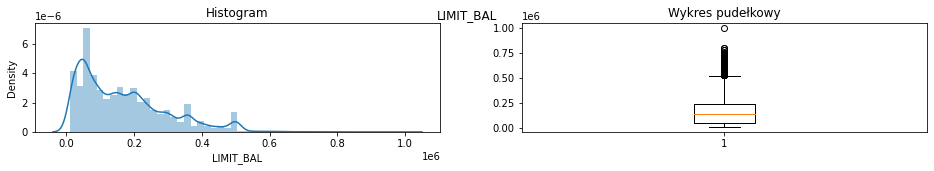

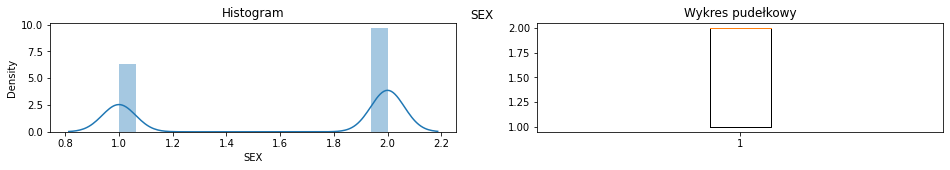

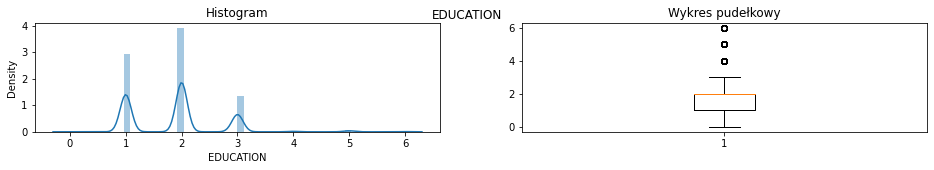

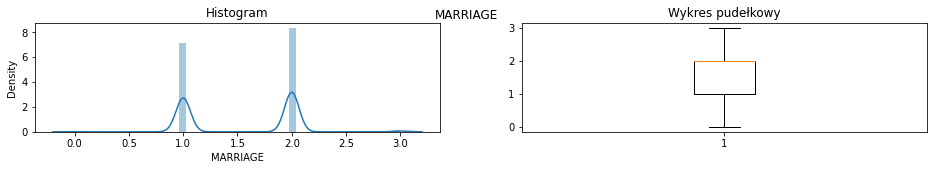

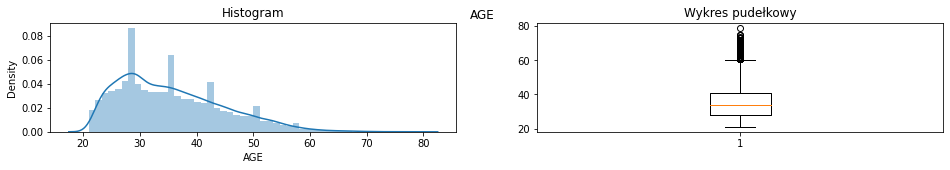

...

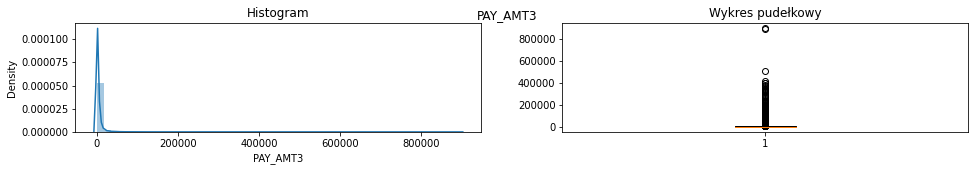

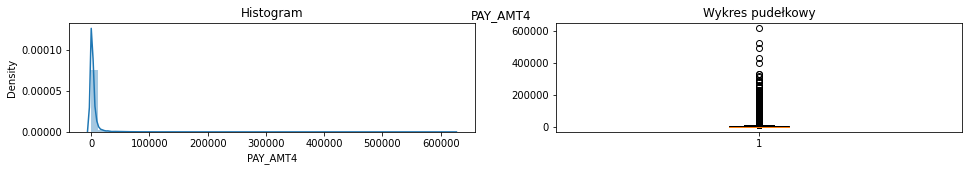

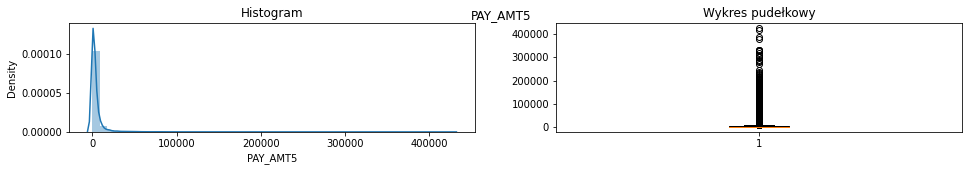

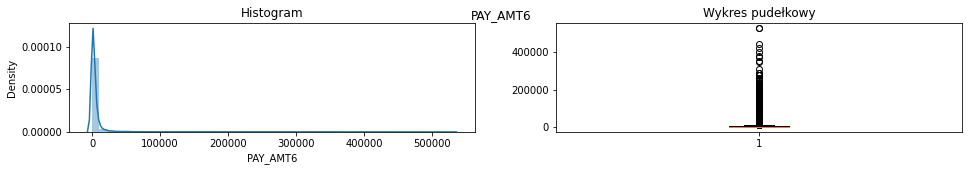

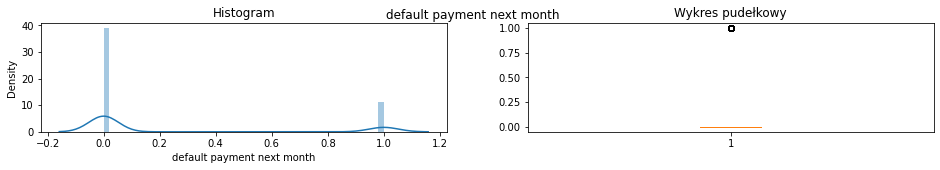

In [5]:
for variable in dataframe.select_dtypes(include=np.number).columns:
    fig = plt.figure(figsize=(16, 2))
    fig.suptitle(variable, fontsize=12)
    plt.subplot(121)
    sns.distplot(dataframe[variable], kde=True, rug=False)
    plt.title('Histogram')
    plt.subplot(122)
    plt.boxplot(dataframe[variable])
    plt.title('Wykres pudełkowy')
    plt.show()

Z powyższego wynika, że średnia wartość udzielonego kredytu klientowi wynosi blisko 170 tys. dolarów. Wiekszość klientów to niezamężne kobiety z wykształceniem wyższym w wieku ok. 35 lat. W przeważającej większości dokonują spłaty zobowiązań w terminie o średniej wartości miesięcznej 5 tys. dolarów, a ich stan rachunku jest dodatni. W przeważającej większości przypadków zamieszczonych w analizowanym zestawieniu decyzja o przyznaniu karty kredytowej jest negatywna.

Dodanie kolumn, których wartości posłużą do dalszych analiz

In [10]:
dataframe['average_BILL'] = dataframe[['BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6']].mean(axis=1)
dataframe['average_PAY'] = dataframe[['PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']].mean(axis=1)
dataframe.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month,average_BILL,average_PAY
0,20000,2,2,1,24,2,2,-1,-1,-2,...,0,0,689,0,0,0,0,1,1284.000000,114.833333
1,120000,2,2,2,26,-1,2,0,0,0,...,3261,0,1000,1000,1000,0,2000,1,2846.166667,833.333333
2,90000,2,2,2,34,0,0,0,0,0,...,15549,1518,1500,1000,1000,1000,5000,0,16942.166667,1836.333333
3,50000,2,2,1,37,0,0,0,0,0,...,29547,2000,2019,1200,1100,1069,1000,0,38555.666667,1398.000000
4,50000,1,2,1,57,-1,0,-1,0,0,...,19131,2000,36681,10000,9000,689,679,0,18223.166667,9841.500000


Podział na zmienną objaśnianą y i zmienne objaśniające X

In [11]:
features = ['LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'average_BILL', 'average_PAY']
target = 'default payment next month'
X, y = dataframe[features], dataframe[target]

In [9]:
pd.Series(y).value_counts(normalize=True)

0    0.7788
1    0.2212
Name: default payment next month, dtype: float64

Rozkład danych

In [12]:
X.describe()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,average_BILL,average_PAY
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,...,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.00000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000
mean,167484.322667,1.603733,1.853133,1.551867,35.485500,-0.016700,-0.133767,-0.166200,-0.220667,-0.266200,...,40311.400967,38871.760400,5663.580500,5.921163e+03,5225.68150,4826.076867,4799.387633,5215.502567,44976.945200,5275.232094
std,129747.661567,0.489129,0.790349,0.521970,9.217904,1.123802,1.197186,1.196868,1.169139,1.133187,...,60797.155770,59554.107537,16563.280354,2.304087e+04,17606.96147,15666.159744,15278.305679,17777.465775,63260.721860,10137.946323
min,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,...,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.00000,0.000000,0.000000,0.000000,-56043.166667,0.000000
25%,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,1763.000000,1256.000000,1000.000000,8.330000e+02,390.00000,296.000000,252.500000,117.750000,4781.333333,1113.291667
50%,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,18104.500000,17071.000000,2100.000000,2.009000e+03,1800.00000,1500.000000,1500.000000,1500.000000,21051.833333,2397.166667
75%,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,50190.500000,49198.250000,5006.000000,5.000000e+03,4505.00000,4013.250000,4031.500000,4000.000000,57104.416667,5583.916667
max,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,8.000000,...,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.00000,621000.000000,426529.000000,528666.000000,877313.833333,627344.333333


Porównanie zmiennych numerycznych X do zmiennej kategorycznej y z wykorzystaniem histogramów

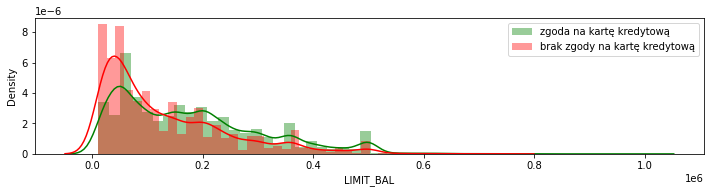

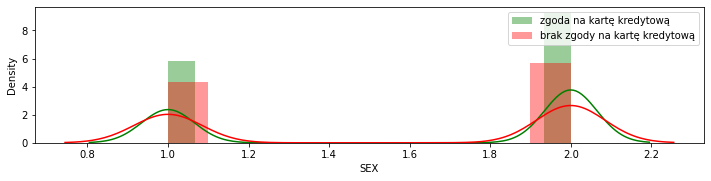

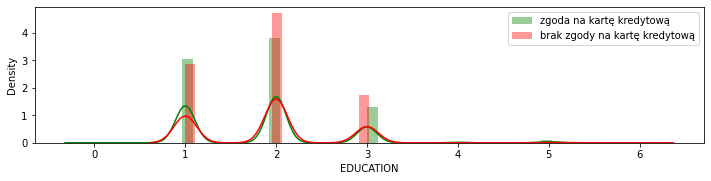

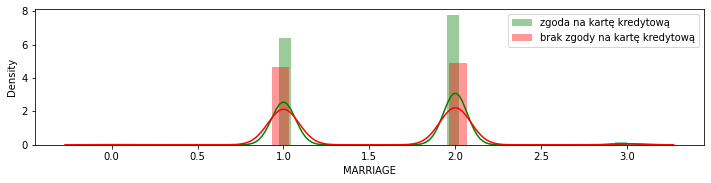

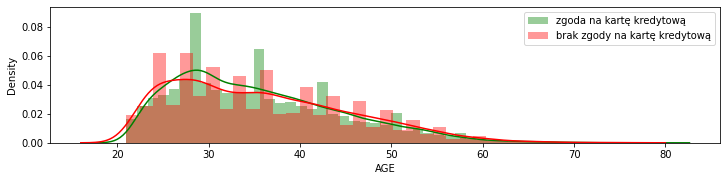

...

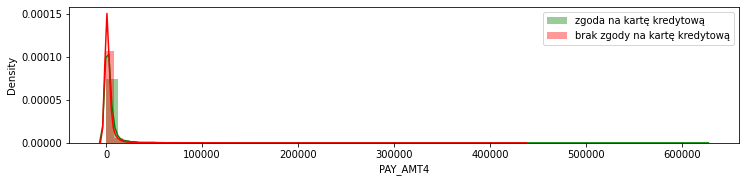

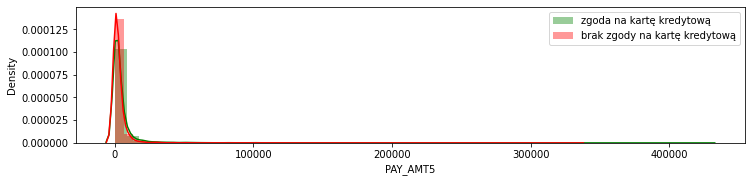

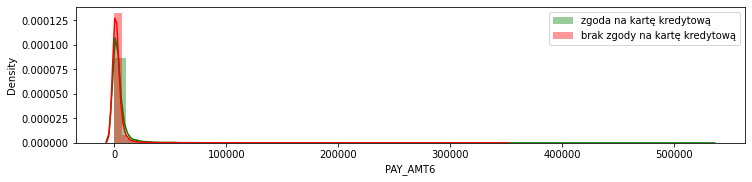

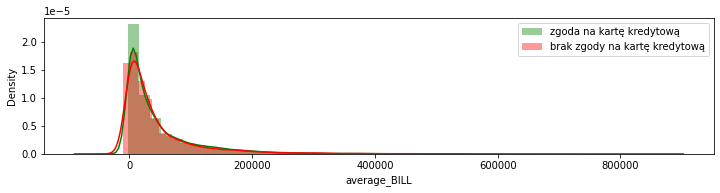

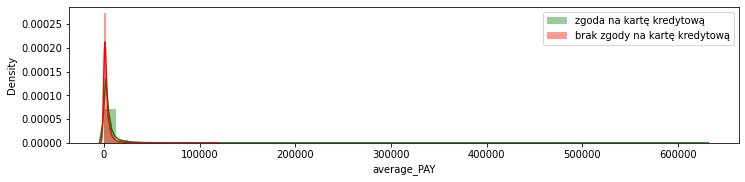

In [14]:
import seaborn as sns
for col in features:
    plt.figure(figsize=(12, 2.5))
    sns.distplot(dataframe.loc[dataframe['default payment next month']==0, col], kde=True, rug=False, color='green', label='zgoda na kartę kredytową')
    sns.distplot(dataframe.loc[dataframe['default payment next month']==1, col], kde=True, rug=False, color='red', label='brak zgody na kartę kredytową')
    plt.legend(loc='upper right')
    plt.show()

Porównanie zmiennych numerycznych X do zmiennej kategorycznej y z wykorzystaniem histogramów

Unique values: 81


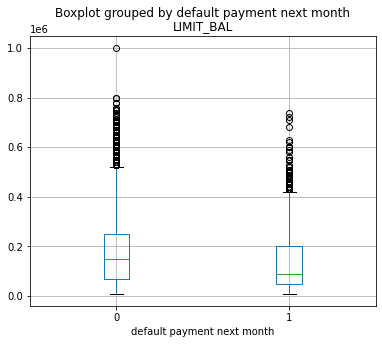

Unique values: 2


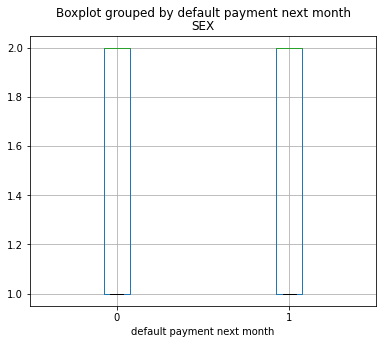

Unique values: 7


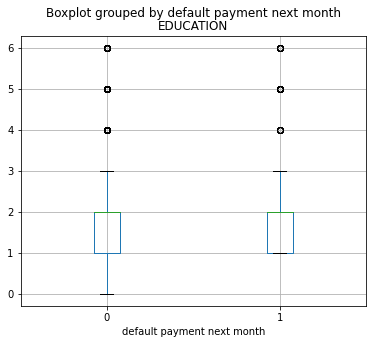

Unique values: 4


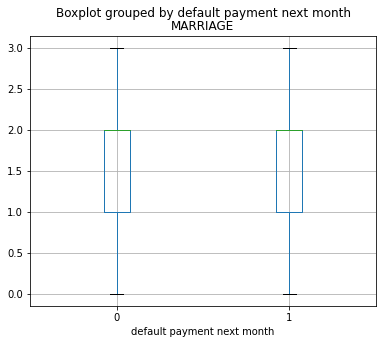

Unique values: 56


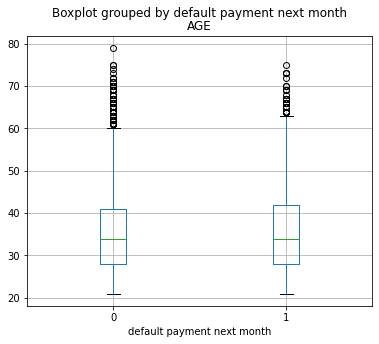

Unique values: 11


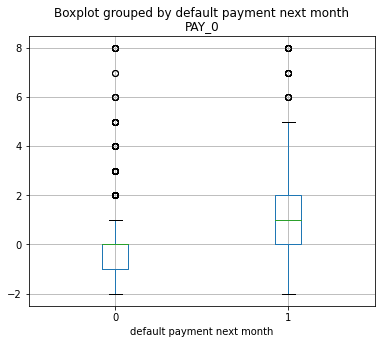

Unique values: 11


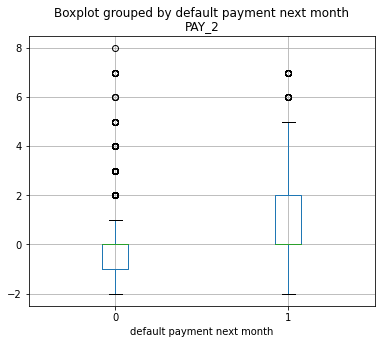

Unique values: 11


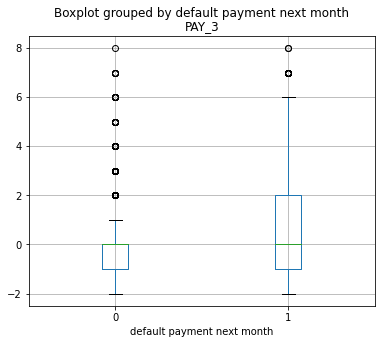

Unique values: 11


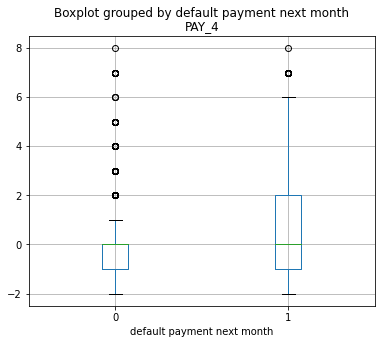

Unique values: 10


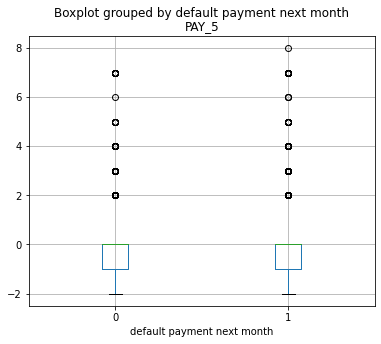

Unique values: 10


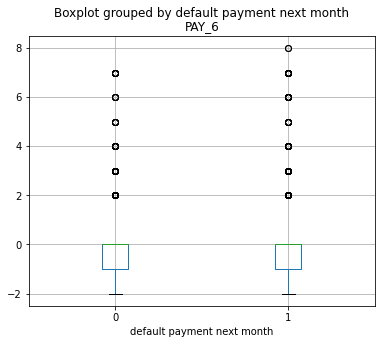

Unique values: 22723


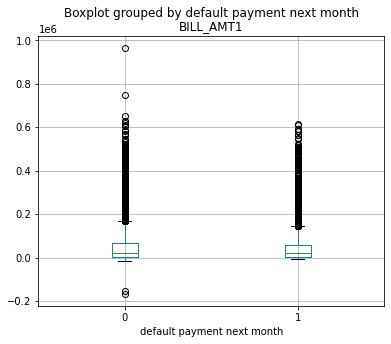

Unique values: 22346


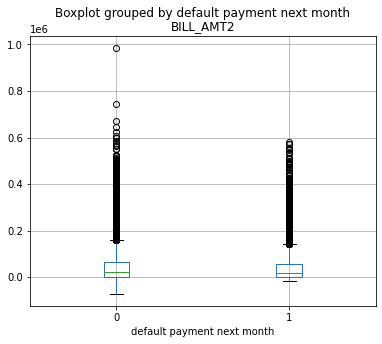

Unique values: 22026


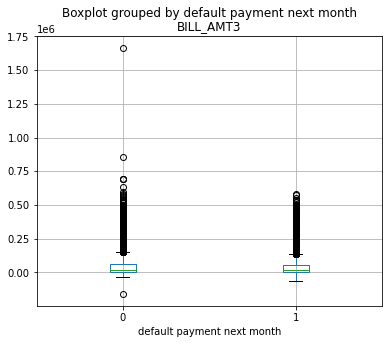

Unique values: 21548


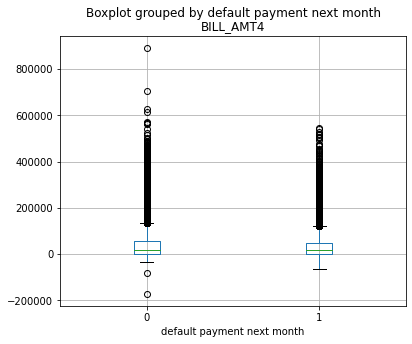

Unique values: 21010


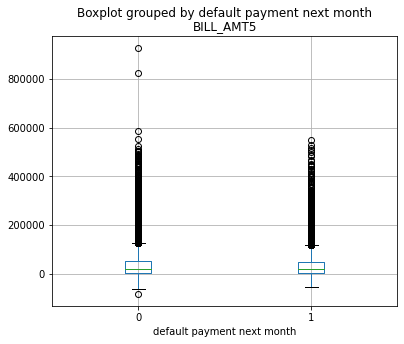

Unique values: 20604


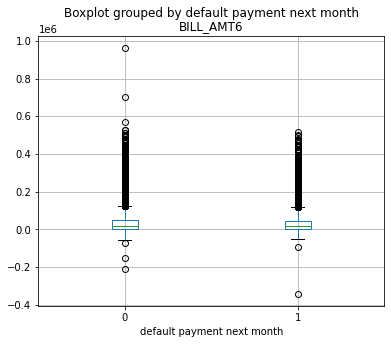

Unique values: 7943


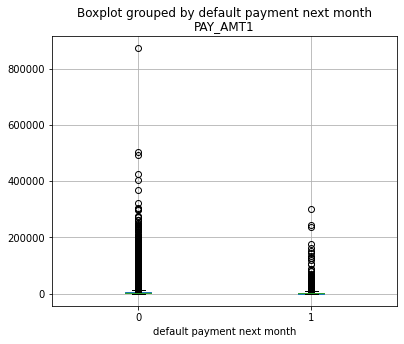

Unique values: 7899


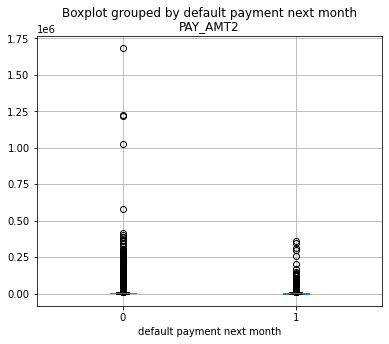

Unique values: 7518


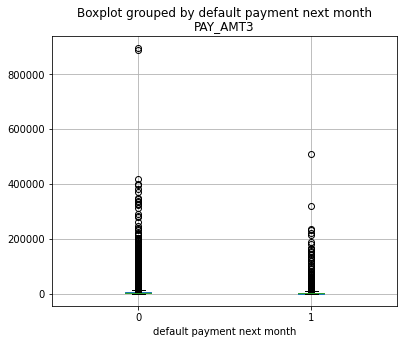

Unique values: 6937


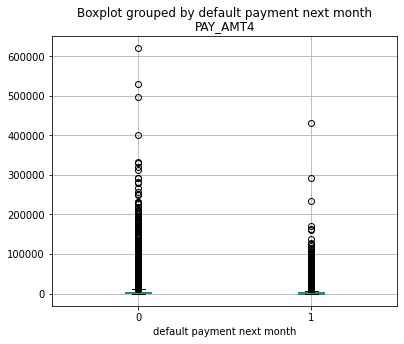

Unique values: 6897


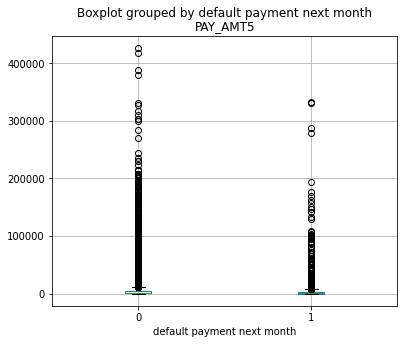

Unique values: 6939


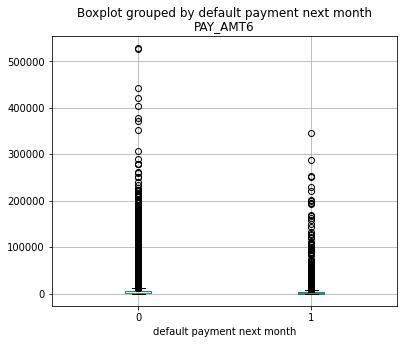

Unique values: 27370


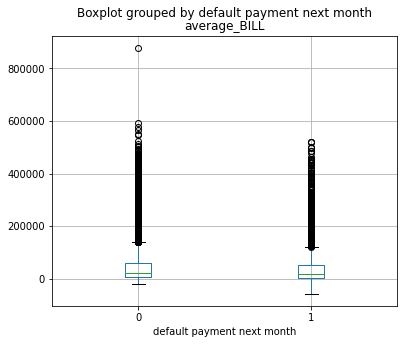

Unique values: 19180


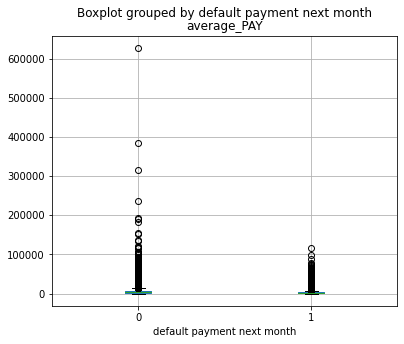

In [15]:
import matplotlib.pyplot as plt
for col in features:
    print(f'Unique values: {len(dataframe[col].unique())}')
    dataframe.boxplot(column=col, by='default payment next month', figsize=(6,5))
    plt.title(col)
    plt.show()

Z powyższych wizualizacji wynika brak wyraźnej zależności danych objaśniających X a daną objaśnianą y, czyli wydawaniem decyzji o przyznaniu karty kredytowej. Jednakże w przypadku zmiennych 'PAY_0', .... 'PAY_6' zarysowuje się korelacja.

Współczynnik korelacji punktowo-dwuseryjnej (Point-biserial correlation coefficient)

In [16]:
from scipy import stats

corr_dict = {}
for col in features:
    corr_dict[col] = stats.pointbiserialr(X[col], y)[0]
pd.Series(corr_dict).sort_values(ascending=False)

PAY_0           0.324794
PAY_2           0.263551
PAY_3           0.235253
PAY_4           0.216614
PAY_5           0.204149
PAY_6           0.186866
EDUCATION       0.028006
AGE             0.013890
BILL_AMT6      -0.005372
BILL_AMT5      -0.006760
BILL_AMT4      -0.010156
average_BILL   -0.012691
BILL_AMT3      -0.014076
BILL_AMT2      -0.014193
BILL_AMT1      -0.019644
MARRIAGE       -0.024339
SEX            -0.039961
PAY_AMT6       -0.053183
PAY_AMT5       -0.055124
PAY_AMT3       -0.056250
PAY_AMT4       -0.056827
PAY_AMT2       -0.058579
PAY_AMT1       -0.072929
average_PAY    -0.102354
LIMIT_BAL      -0.153520
dtype: float64

Z powyższego wynika dodatnia słaba korelacja pomiędzy zmianną objaśnianą y a siedmioma zmiennymi objaśniającymi X (tj. "PAY_0", ... "PAY_6", "EDUCATION"), co oznacza, że jak wartość X rośnie, to i wartość y również. Wartości kolumn "PAY_0", ... "PAY_6" prezentują ujemne wartości w przypadku spłacania udzielonego klientowi zadłużenia do wyznaczonego terminu, wtedy też częściej następuje pozytywna decyzja o udzieleniu linii kredytowej opisana wartością '0' zmiennej objaśnianej y.

Pozostałe zmienne X mają słabą ujemną korelację ze zmienną y, co oznacza, że jak wartość jednej rośnie, to drugiej maleje.

Raport Exploratory Data Analysis

In [17]:
from pandas_profiling import ProfileReport

profile = ProfileReport(dataframe, title="Klasyfikacja - karty kredytowe")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Na powyższej wizualizacji korelacji zmiennych objaśniających X i zmienne objaśnianej y nie widać wyraźnej zależności. Jednakże słaba zależność pojawia się pomiędzy zmiennymi X prezentującymi terminowość spłaty zadłużenia (przede wszystkim w ostatnim badanym okresie, czyli wrzesień 2005 roku oznaczonym jak PAY_0), a decyzją o przyznaniu karty kredytowej.

Natomiast widoczna jest wyraźna zależność pomiędzy częścią zmiennych objaśniających X prezentującymi zaleganie/niezaleganie ze spłatami kredytów w poszczególnych okresach następujących po sobie (w badanym przedziale czasowym pomiędzy kwiecień 2005 a wrzesień 2005). Z powyższego można wnioskować, że jeśli ktoś nie zalega z opłatami w danym miesiącu, to i w kolejnym nie będzie zalegał i na odwrót. Podobna zależność występuje także w przypadku zmiennych opisujących wartość rachunku klienta oraz wartość dokonywanych płatności w poszczególnych badanych okresach.

Podział danych na zbiór treningowy i testowy

In [18]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=0, stratify=y)
print ('Treningowe obserwacje: %d\nTestowe obserwacje: %d' % (X_train.shape[0], X_test.shape[0]))

Treningowe obserwacje: 21000
Testowe obserwacje: 9000


# Modelowanie i ewaluacja

Uczenie modelu - regresja logistyczna (model parametryczny)

Wystandaryzowany X dla zbioru treningowego oraz testowego

In [19]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler

scaler_2var = StandardScaler()
X_train_standardized = scaler_2var.fit_transform(X_train)
X_test_standardized = scaler_2var.fit_transform(X_test)

model_lr = LogisticRegression()
params_rf = {'C': [1.0, 2.0, 3.0, 4.0],
             'max_iter': [50, 100, 130, 180]}
rf_gridsearch = GridSearchCV(model_lr,
                             params_rf,
                             scoring='f1_macro',
                             cv=5,
                             verbose=10, n_jobs=-1)
rf_gridsearch.fit(X_train, y_train)
print('\nNajlepsze hiperparametry:', rf_gridsearch.best_params_)
rf_model_v2 = rf_gridsearch.best_estimator_

Fitting 5 folds for each of 16 candidates, totalling 80 fits

Najlepsze hiperparametry: {'C': 3.0, 'max_iter': 130}


Prognoza na zbiorze testowym z wykorzystaniem modelu regresji logistycznej.
Porównanie prognozy z wartościami prawdziwym dla 5 pierwszych oraz 5 ostatnich wartości.

In [20]:
model_lr = LogisticRegression()
model_lr.fit(X_train_standardized, y_train)

LogisticRegression()

In [21]:
predictions_lr = model_lr.predict(X_test_standardized)
print('Predicted labels: ', predictions_lr[:5], predictions_lr[-5:])
print('Actual labels:    ' , y_test[:5].values, y_test[-5:].values)

Predicted labels:  [0 0 0 0 0] [0 0 0 0 0]
Actual labels:     [0 0 0 0 0] [0 0 1 0 0]


Porównanie prognozy z wartościami prawdziwymi za pomocą macierzy omyłek

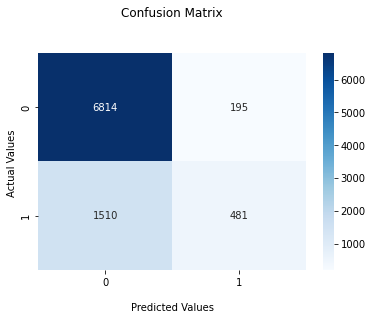

In [22]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

cm = confusion_matrix(y_test, predictions_lr)
ax = sns.heatmap(cm, annot=True, cmap='Blues', fmt='.0f')
ax.set_title('Confusion Matrix\n\n')
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
plt.show()

Model nie radzi sobie w pełni z rozdzieleniem obu klas. Gdy model wskazuje na klasę 1, to nie pokrywa wszystkich obserwacji prawdziwych tej klasy (słaba czułość). Gdy model wskazuje tę klasę, to się myli w ilości przypadków wskazanych w prawym górnym kwadracie (słaba precyzja).

Metryki: dokładność, precyzja, czułość, F1 score

In [23]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

print('Accuracy: ', accuracy_score(y_test, predictions_lr))
print("Precision:", precision_score(y_test, predictions_lr))
print("Recall:", recall_score(y_test, predictions_lr))
print("F1_score:", f1_score(y_test, predictions_lr))

Accuracy:  0.8105555555555556
Precision: 0.7115384615384616
Recall: 0.2415871421396283
F1_score: 0.3607049118860142


Wartość F1 score jest relatywnie niska, co oznacza że model ma precyzję i czułość niskie, albo przynajmniej jedną z nich. Dokładność jest dość wysoka, jednakże metryka ta traci na znaczeniu, gdyż analizowany zbiór jest niestabilny (znaczna przewaga wystepowania jednej klasy nad drugą).

Krzywa ROC oceniająca klasyfikator, regresję logistyczną

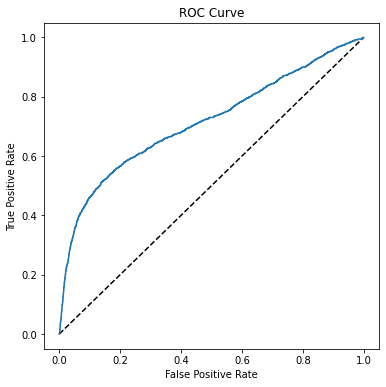

AUC: 0.7146439545797436


In [24]:
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

predictions_probability_lr = model_lr.predict_proba(X_test_standardized)

fpr, tpr, thresholds = roc_curve(y_test, predictions_probability_lr[:,1])

fig = plt.figure(figsize=(6, 6))

plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr, tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

auc = roc_auc_score(y_test, predictions_probability_lr[:,1])
print('AUC: ' + str(auc))

Wykres AUC (Area Under the Curve) jest to pole znajdujące się pod krzywą ROC. Krzywa ROC to wykres TPR (True Positives Rate, czyli czułość) oraz FPR (False Positives Rate, czyli specyficzność) w zależności od punktu odcięcia. Najlepszy model to taki, który jest najbliżej lewego górnego rogu wykresu, czyli należy dążyć do TPR równego 1 i FPR równego 0.

# 2 model parametryczny - KNN (K Nearest Neighbours)

Uczenie modelu - KNN

Wystandaryzowany X dla zbioru treningowego oraz testowego

In [25]:
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler

scaler_2var = StandardScaler()
X_train_standardized = scaler_2var.fit_transform(X_train)
X_test_standardized = scaler_2var.fit_transform(X_test)

model_knn = KNeighborsClassifier()
params_knn = {'n_neighbors': [1, 2, 3, 4, 5],
             'weights': ['uniform', 'distance']}
knn_gridsearch = GridSearchCV(model_knn,
                             params_knn,
                             scoring='f1_macro',
                             cv=5,
                             verbose=10, n_jobs=-1)
knn_gridsearch.fit(X_train, y_train)
print('\nNajlepsze hiperparametry:', knn_gridsearch.best_params_)
knn_model_v2 = knn_gridsearch.best_estimator_

Fitting 5 folds for each of 10 candidates, totalling 50 fits

Najlepsze hiperparametry: {'n_neighbors': 3, 'weights': 'distance'}


Prognoza na zbiorze testowym z wykorzystaniem modelu KNN.
Porównanie prognozy z wartościami prawdziwym dla 5 pierwszych oraz 5 ostatnich wartości.

In [26]:
model_knn = KNeighborsClassifier()
model_knn.fit(X_train_standardized, y_train)

KNeighborsClassifier()

In [27]:
predictions_knn = model_knn.predict(X_test_standardized)
print('Predicted labels: ', predictions_knn[:5], predictions_knn[-5:])
print('Actual labels:    ' , y_test[:5].values, y_test[-5:].values)

Predicted labels:  [0 0 0 0 0] [0 0 0 0 0]
Actual labels:     [0 0 0 0 0] [0 0 1 0 0]


Porównanie prognozy z wartościami prawdziwymi za pomocą macierzy omyłek

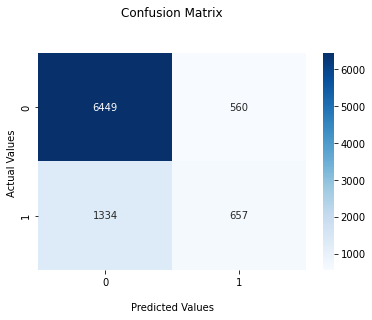

In [28]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

cm = confusion_matrix(y_test, predictions_knn)
ax = sns.heatmap(cm, annot=True, cmap='Blues', fmt='.0f')
ax.set_title('Confusion Matrix\n\n')
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
plt.show()

Podobnie jak w przypadku poprzedniego modelu tak i KNN nie radzi sobie w pełni z rozdzieleniem obu klas

Metryki: dokładność, precyzja, czułość, F1 score

In [29]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

print('Accuracy: ', accuracy_score(y_test, predictions_knn))
print("Precision:", precision_score(y_test, predictions_knn))
print("Recall:", recall_score(y_test, predictions_knn))
print("F1_score:", f1_score(y_test, predictions_knn))

Accuracy:  0.7895555555555556
Precision: 0.5398520953163517
Recall: 0.32998493219487696
F1_score: 0.4096009975062344


Krzywa ROC oceniająca klasyfikator, KNN

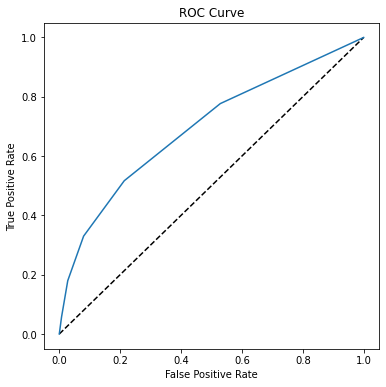

AUC: 0.6950611823687404


In [30]:
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

predictions_probability_knn = model_knn.predict_proba(X_test_standardized)

fpr, tpr, thresholds = roc_curve(y_test, predictions_probability_knn[:,1])

fig = plt.figure(figsize=(6, 6))

plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr, tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

auc = roc_auc_score(y_test, predictions_probability_knn[:,1])
print('AUC: ' + str(auc))

Accuracy: Wartość tej metryki prezentującej dokładność jest nieco niższa w przypadku modelu KNN niż wyliczona dla modelu LR. Jednakże w analizowanym zbiorze danych jedna z klas jest rzadka, a tym samym zbiór jest niezbalansowany. W takim zbiorze metryka dokładności traci na znaczeniu.

Precision: Również precyzja spadła w przypadku KNN w odniesieniu do modelu LR, co może świadczyć o underfittingu.

Recall: Natomiast wartość metryki czułość wzrosła w porównaniu do tej zmierzonej dla modelu regresji logistycznej.

F1 score: Metryka F1, będąca średnią harmoniczną precyzyji i czułości wzrosła dla modelu KNN w porównaniu do wartości F1 wyliczonej dla modelu LR.

Z powyższych metryk wynika, że oba modele nie prognozują zbyt trafnie. Być może ich działanie polepszyłoby się po wyszukaniu i dopasowaniu odpowiednich wartości dla pozostałych hiperparametrów obu klasyfikatorów. Poza tym słabe korelacje pomiędzy zmiennymi objaśniajacymi X, a zmienną objaśnianą y nie sprzyjają trafnemu prognozowaniu.

# 3 model nieparametryczny - drzewo decyzyjne

Uczenie modelu - drzewo decyzyjne

In [32]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

model_tree= DecisionTreeClassifier()
params_tree = {'max_depth': [2, 3, 5, 7, 10],
          'min_samples_leaf': [2, 3, 5, 7, 10]}
tree_gridsearch = GridSearchCV(model_tree,
                               params_tree,
                               scoring='f1_macro',
                               cv=5,
                               verbose=10,
                               n_jobs=-1)
tree_gridsearch.fit(X_train, y_train)
print('\nNajlepsze hiperparametry:', tree_gridsearch.best_params_)
tree_model = tree_gridsearch.best_estimator_

Fitting 5 folds for each of 25 candidates, totalling 125 fits

Najlepsze hiperparametry: {'max_depth': 5, 'min_samples_leaf': 10}


Prognoza na zbiorze testowym z wykorzystaniem modelu drzewa decyzyjnego.
Porównanie prognozy z wartościami prawdziwym dla 5 pierwszych oraz 5 ostatnich wartości.

In [33]:
model_tree = DecisionTreeClassifier()
model_tree.fit(X_train_standardized, y_train)

DecisionTreeClassifier()

In [34]:
predictions_tree = model_tree.predict(X_test_standardized)
print('Predicted labels: ', predictions_tree[:5], predictions_tree[-5:])
print('Actual labels:    ' , y_test[:5].values, y_test[-5:].values)

Predicted labels:  [0 0 0 0 0] [0 0 0 0 0]
Actual labels:     [0 0 0 0 0] [0 0 1 0 0]


Porównanie prognozy z wartościami prawdziwymi za pomocą macierzy omyłek

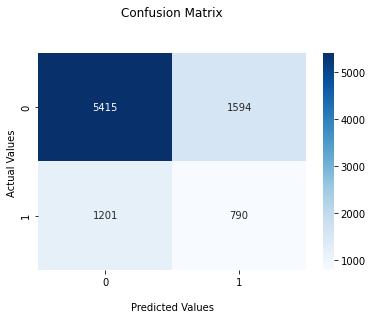

In [35]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

cm = confusion_matrix(y_test, predictions_tree)
ax = sns.heatmap(cm, annot=True, cmap='Blues', fmt='.0f')
ax.set_title('Confusion Matrix\n\n')
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
plt.show()

Podobnie jak w przypadku dwóch poprzednio analizowancyh modeli, także i ten nie radzi sobie w pełni z rozdzieleniem obu klas

Metryki: dokładność, precyzja, czułość, F1 score

In [36]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

print('Accuracy: ', accuracy_score(y_test, predictions_tree))
print("Precision:", precision_score(y_test, predictions_tree))
print("Recall:", recall_score(y_test, predictions_tree))
print("F1_score:", f1_score(y_test, predictions_tree))

Accuracy:  0.6894444444444444
Precision: 0.3313758389261745
Recall: 0.39678553490708185
F1_score: 0.36114285714285715


Podobnie jak w przypadku wartości metryk dwóch uprzednio analizowanych modeli, także tutaj F1 jest niskie. Dokładność jest jeszcze niższa, ale traci na znaczeniu, gdyż analizowany zbiór danych jest niezbalansowany

Krzywa ROC oceniająca klasyfikator, drzewo decyzyjne

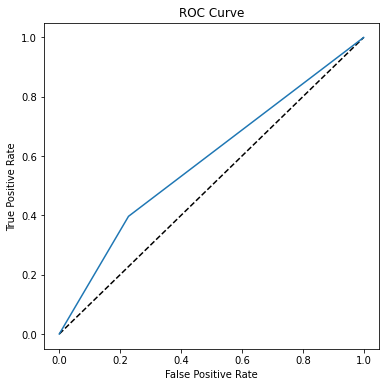

AUC: 0.5846818243803493


In [37]:
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

predictions_probability_tree = model_tree.predict_proba(X_test_standardized)

fpr, tpr, thresholds = roc_curve(y_test, predictions_probability_tree[:,1])

fig = plt.figure(figsize=(6, 6))

plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr, tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

auc = roc_auc_score(y_test, predictions_probability_tree[:,1])
print('AUC: ' + str(auc))

Metryki modelu nieparametrycznego wskazują na jego jeszcze gorsze dopasowanie w odniesieniu do badanych dwóch pozostałych modeli